In [3]:
import pandas as pd
import numpy as np
from math import radians, sin, cos, sqrt, atan2
import folium

# Load the metadata CSV
filename = 'meta_data_for_all_active_systems_for_calculation_20250401(CSV).csv'
df = pd.read_csv(filename)

# Filter for USBR stations only
df = df[df['COLLECTION_SYSTEM'] == 'USBR'].copy()

# Required columns
required_cols = ['STATION_ID', 'LAT', 'LON', 'SiteType',
                 'COLLECTION_SYSTEM', 'SYSTEM_NAME', 'MasterStationName']
if not all(col in df.columns for col in required_cols):
    raise ValueError(f"CSV must contain columns: {required_cols}")

# Haversine function
def haversine(lat1, lon1, lat2, lon2):
    R = 6371000  # meters
    phi1, phi2 = radians(lat1), radians(lat2)
    dphi = radians(lat2 - lat1)
    dlambda = radians(lon2 - lon1)
    a = sin(dphi / 2)**2 + cos(phi1) * cos(phi2) * sin(dlambda / 2)**2
    return 2 * R * atan2(sqrt(a), sqrt(1 - a))

# Distance threshold in meters (100 ft = ~30.48 meters)
distance_threshold = 30.48

# Find similar station pairs with metadata
similar_pairs = []
for i, row1 in df.iterrows():
    for j, row2 in df.iloc[i+1:].iterrows():
        if row1['SiteType'] == row2['SiteType']:
            dist = haversine(row1['LAT'], row1['LON'], row2['LAT'], row2['LON'])
            if dist <= distance_threshold:
                similar_pairs.append({
                    'Station1_ID': row1['STATION_ID'],
                    'Station1_LAT': row1['LAT'],
                    'Station1_LON': row1['LON'],
                    'Station1_CollectionSystem': row1['COLLECTION_SYSTEM'],
                    'Station1_SystemName': row1['SYSTEM_NAME'],
                    'Station1_MasterName': row1['MasterStationName'],
                    'Station2_ID': row2['STATION_ID'],
                    'Station2_LAT': row2['LAT'],
                    'Station2_LON': row2['LON'],
                    'Station2_CollectionSystem': row2['COLLECTION_SYSTEM'],
                    'Station2_SystemName': row2['SYSTEM_NAME'],
                    'Station2_MasterName': row2['MasterStationName'],
                    'Distance_m': round(dist, 2),
                    'SiteType': row1['SiteType']
                })

# Create and sort DataFrame

# Create DataFrame only if there are results
if similar_pairs:
    similar_df = pd.DataFrame(similar_pairs)
    similar_df.sort_values(by='Distance_m', ascending=False, inplace=True)
    similar_df.to_csv('similar_stations_by_location_and_type_2.0.csv', index=False)
    print(f"Found {len(similar_df)} similar station pairs. CSV saved.")
else:
    print("No similar station pairs found under current filters (USBR, same SiteType, within 100 ft).")
similar_df = pd.DataFrame(similar_pairs)
similar_df.sort_values(by='Distance_m', ascending=False, inplace=True)

# Export to CSV
similar_df.to_csv('similar_stations_by_location_and_type_2.0.csv', index=False)
print("Similar station pairs saved to 'USBR_similar_stations_by_location_and_type_2.0.csv'")

No similar station pairs found under current filters (USBR, same SiteType, within 100 ft).


KeyError: 'Distance_m'

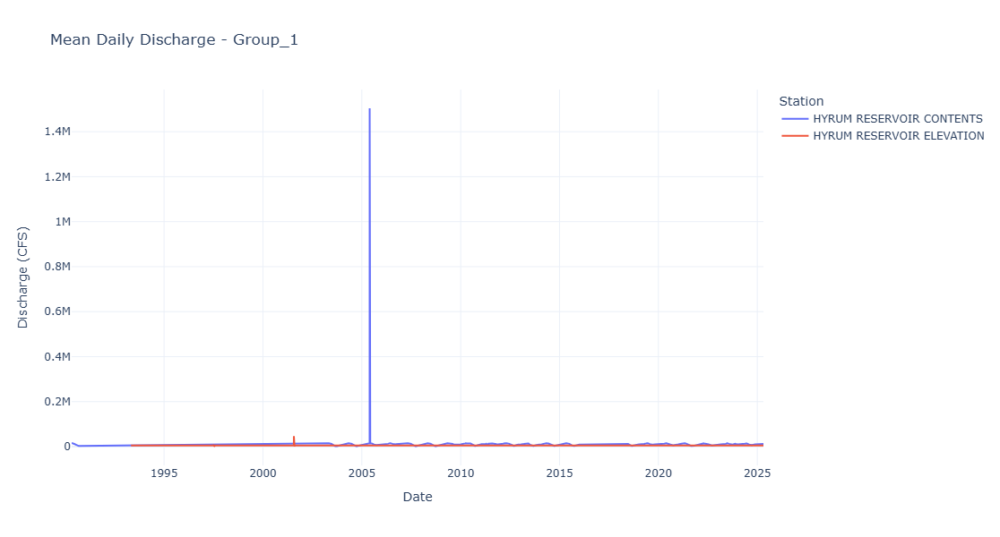

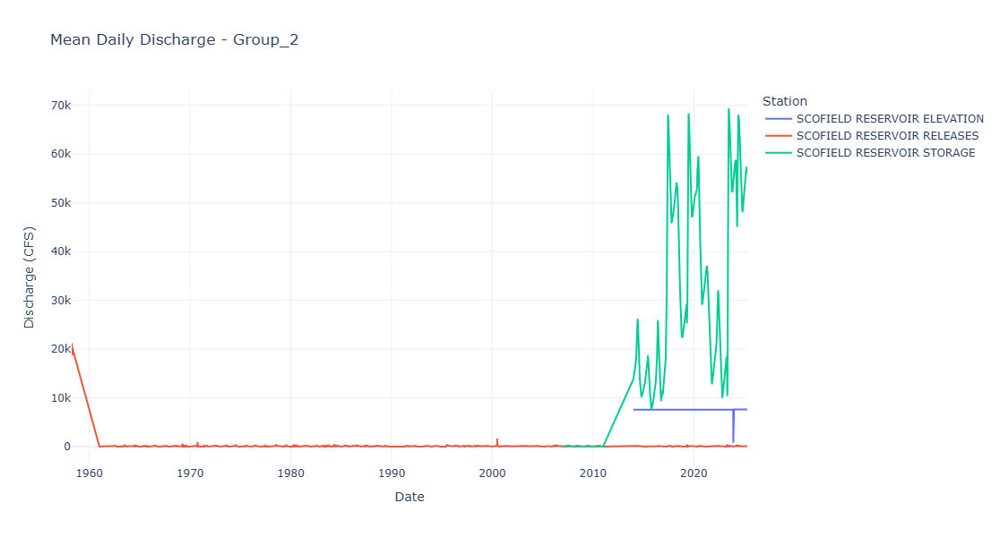

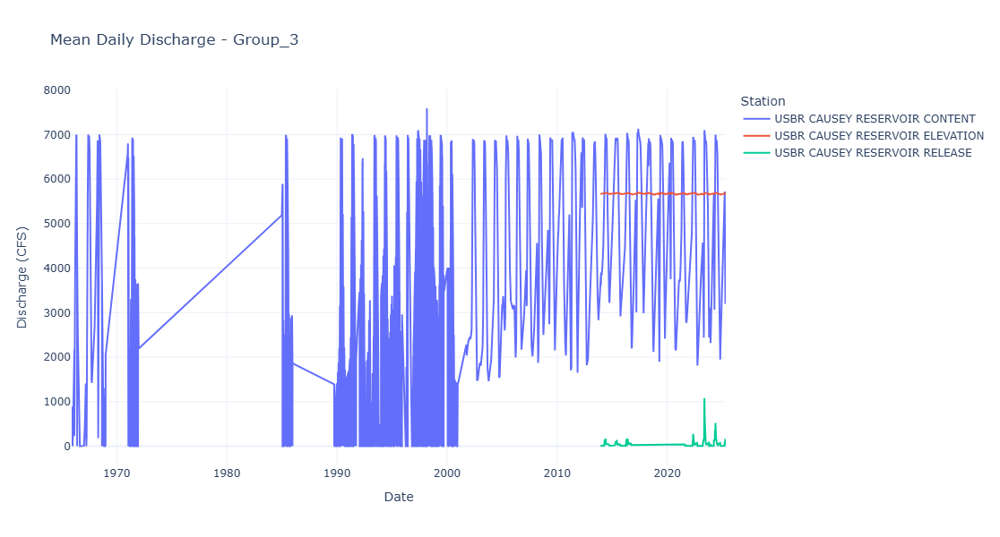

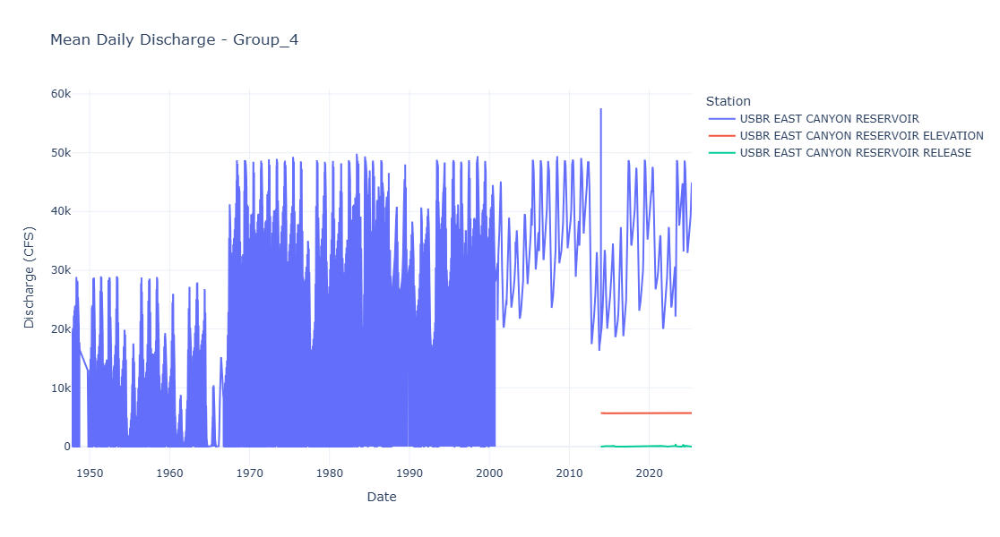

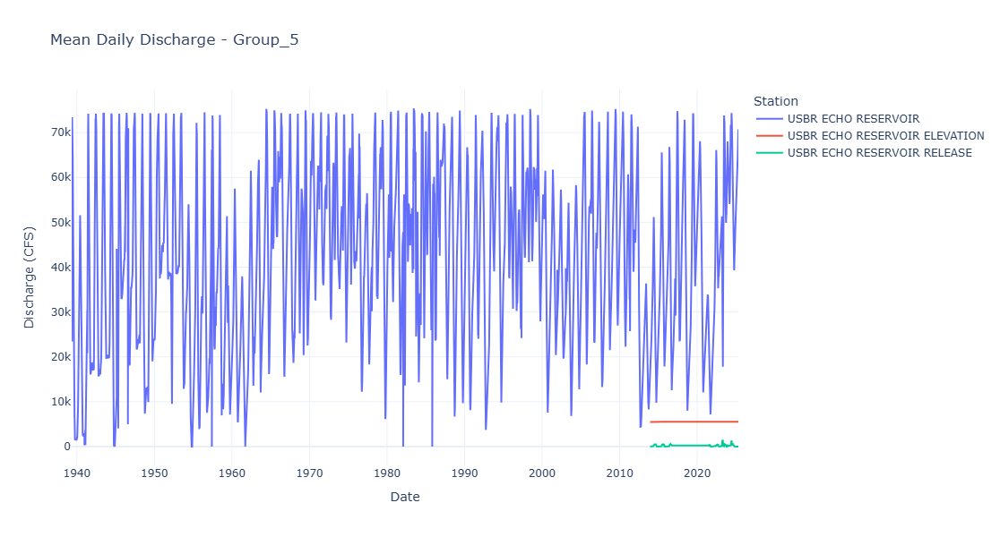

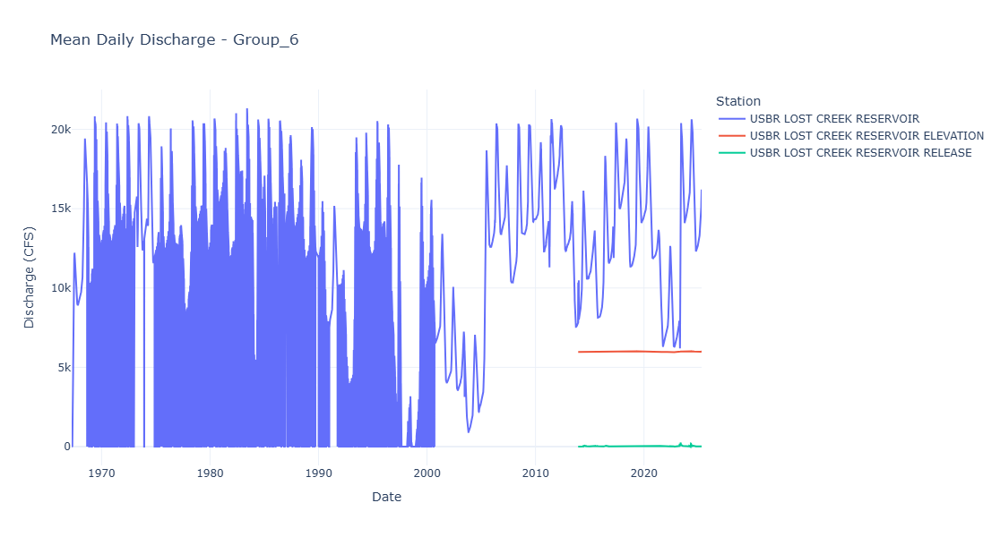

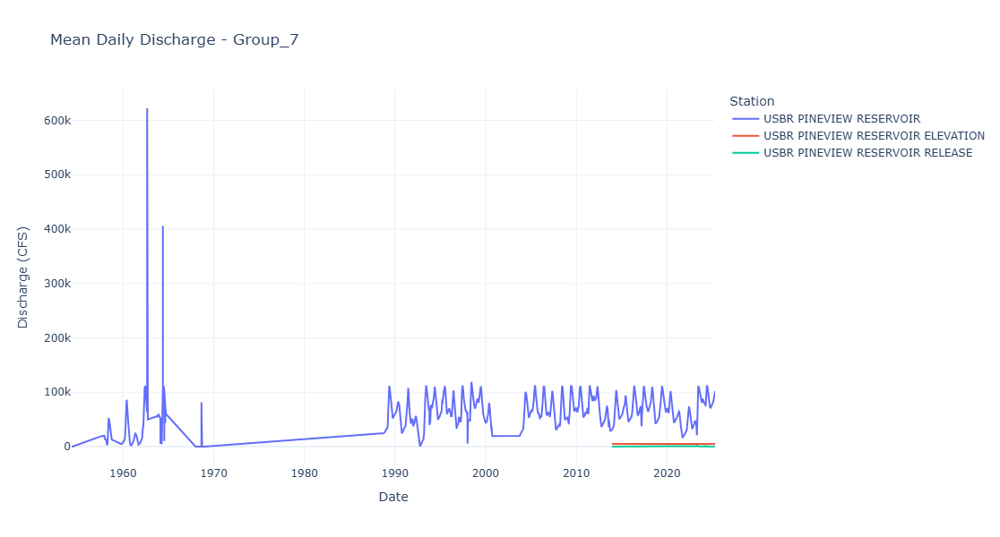

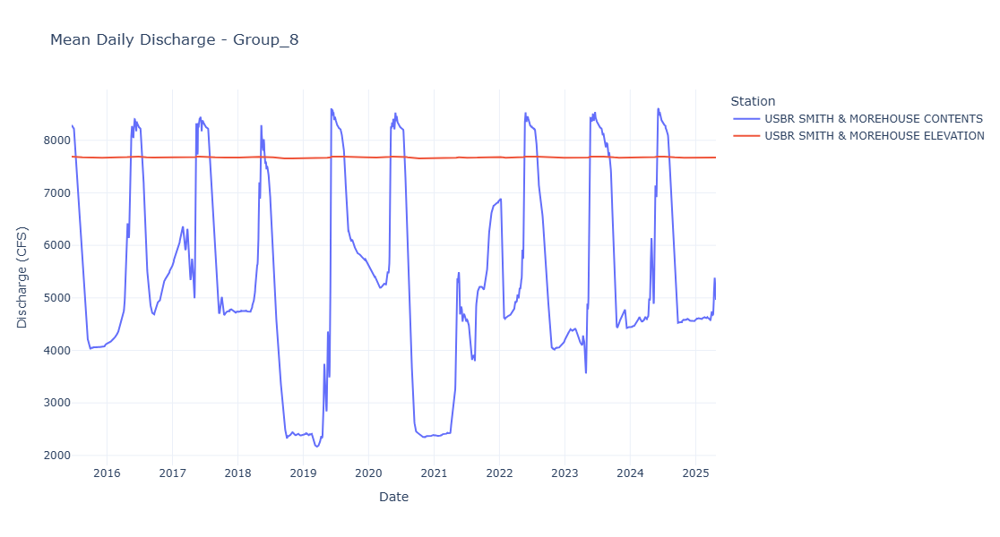

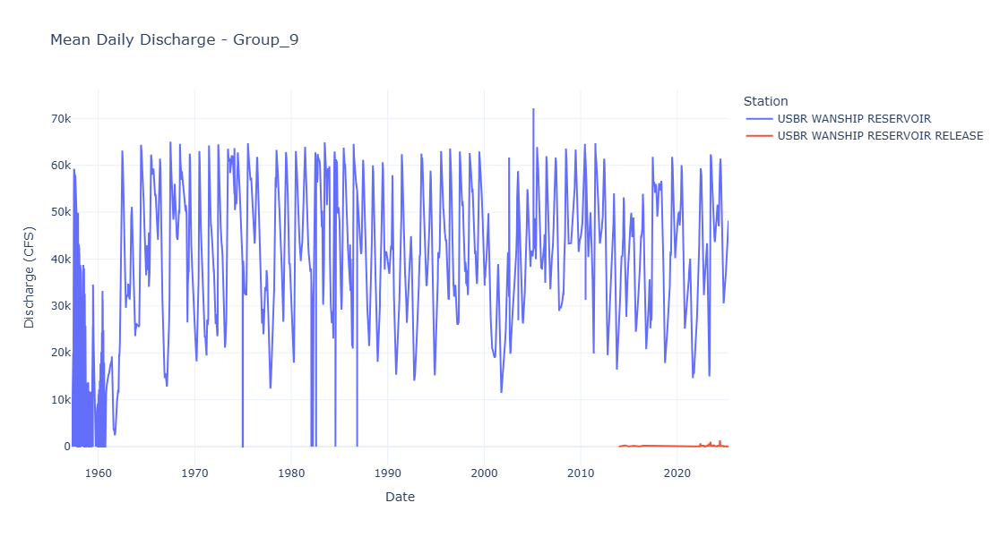

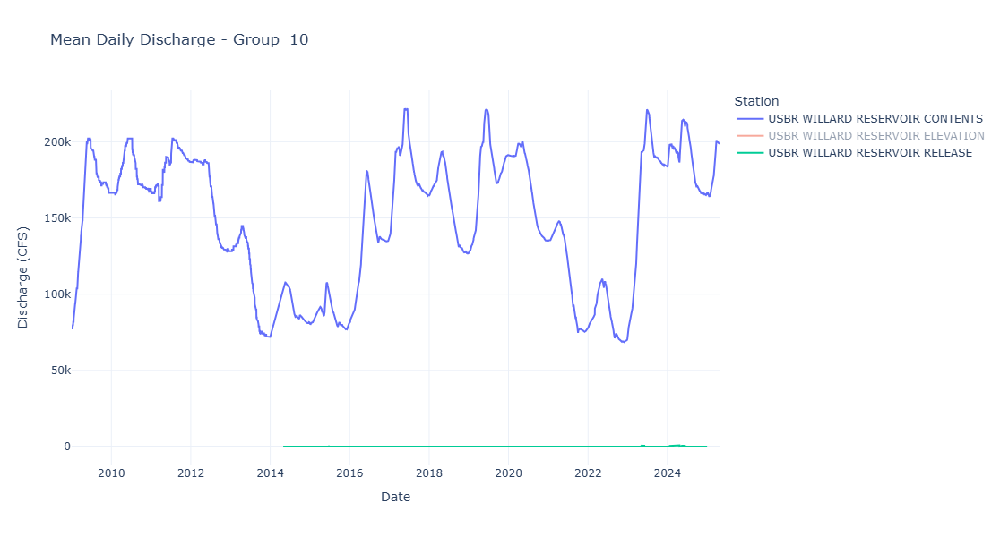

In [4]:
import requests
import pandas as pd
from datetime import datetime
import plotly.graph_objects as go

# Define your 28 groups with site_ids
station_groups = {
    "Group_1": ["2787", "9740"],
    "Group_2": ["10020", "73", "9668"],
    "Group_3": ["2559", "9864", "9865"],
    "Group_4": ["538", "9850", "9851"],
    "Group_5": ["535", "9852", "9853"],
    "Group_6": ["536", "9854", "9855"],
    "Group_7": ["2907", "9858", "9859"],
    "Group_8": ["9997", "9998"],
    "Group_9": ["500", "9857"],
    "Group_10": ["9627", "9867", "9911"],
}

# Get today's date
end_date = datetime.today().strftime("%Y-%m-%d")

# Loop through each group
for plot_name, site_ids in station_groups.items():
    fig = go.Figure()
    
    for DivrtID in site_ids:
        api_url = f"https://www.waterrights.utah.gov/dvrtdb/daily-chart.asp?station_id={DivrtID}&end_date={end_date}&f=json"
        response = requests.get(api_url)

        if response.status_code == 200:
            data = response.json()
            if "data" in data:
                df = pd.DataFrame(data["data"], columns=["date", "value"])
                df.rename(columns={"date": "Date", "value": "DISCHARGE"}, inplace=True)
                df["Date"] = pd.to_datetime(df["Date"])
                df["DISCHARGE"] = pd.to_numeric(df["DISCHARGE"], errors="coerce")
                station_name = data.get("station_name", f"Station {DivrtID}")

                fig.add_trace(go.Scatter(
                    x=df["Date"], y=df["DISCHARGE"],
                    mode="lines",
                    name=station_name,
                    connectgaps=False
                ))
            else:
                print(f"No data found for station {DivrtID}")
        else:
            print(f"Error fetching data for station {DivrtID}: {response.status_code}")

    # Use the current group's name in the plot title
    fig.update_layout(
        title=f"Mean Daily Discharge - {plot_name}",
        xaxis_title="Date",
        yaxis_title="Discharge (CFS)",
        legend_title="Station",
        template="plotly_white",
        width=1200,
        height=600
    )

    fig.show()